In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import matplotlib.pyplot as plt

import numpy as np

import jax.numpy as jnp
from jax import random

import numpyro
from numpyro.infer import MCMC, NUTS

import h5py

import corner

from jax.scipy.special import erf as scipy_erf

import sys
try:
    sys.path.index('/Users/mayafishbach/Desktop/GWTC3')
except ValueError:
    sys.path.append('/Users/mayafishbach/Desktop/GWTC3')
    
import numpyro_sample
import setup_injections_PE

### Read in injections and PE

In [2]:
default_PE_settings = {
        'dir_O3a' : "/Users/mayafishbach/Desktop/O3samples/O3a/",
        'dir_O3a_p1' : "/Users/mayafishbach/Desktop/O3samples/O3a-p1/",
        'dir_O3b': "/Users/mayafishbach/Desktop/O3samples/O3b/",
        'dir_O2' :  "/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/",  
        'exclude' : ['GW170817', 'GW190425', 'GW190814', 'GW190426', 'GW190909', 'GW190514_065416', 'GW190917', 'GW200105', 'GW200115', 'GW200220_061928', "GW191113_071753", "GW191126_115259", "GW191204_110529", "GW191219_163120", "GW200208_222617", "GW200210_092254", "GW200220_061928", "GW200220_124850", "GW200306_093714", "GW200308_173609", "GW200322_091133"],
        'spin' :  'eff',
        'nsamples' : 1000 
        }

default_injection_settings = {
        'fname' : '/Users/mayafishbach/Desktop/O3samples/injections/o1+o2+o3_bbhpop_real+semianalytic-LIGO-T2100377-v2.hdf5',
        'ifar_thresh' : 1.0,
        'snr_thresh' : 10.0,
        'spin' : 'eff',
        'return_pdraw_dz' : 'True'
        }

inj, Ndraw,  Tobs_years, logpdraw_dz = setup_injections_PE.preprocess_injections(**default_injection_settings)
PEsamples = setup_injections_PE.preprocess_PE(**default_PE_settings)

/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/GW170729_GWTC-1.hdf5
/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/GW151226_GWTC-1.hdf5
/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/GW170809_GWTC-1.hdf5
/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/GW170104_GWTC-1.hdf5
/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/GW170608_GWTC-1.hdf5
/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/GW170814_GWTC-1.hdf5
/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/GW151012_GWTC-1.hdf5
/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/GW170818_GWTC-1.hdf5
/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/GW150914_GWTC-1.hdf5
/Users/mayafishbach/Desktop/O3samples/GWTC-1_sample_release/GW170823_GWTC-1.hdf5
/Users/mayafishbach/Desktop/O3samples/O3a/GW190413_052954.h5
/Users/mayafishbach/Desktop/O3samples/O3a/GW190728_064510.h5
/Users/mayafishbach/Desktop/O3samples/O3a/GW190412.h5
/Users/mayafis

In [3]:
PEsamples = np.array(PEsamples)
nevts = PEsamples.shape[0]

### Define the population model

In [4]:
def evolve_bounded(z, f0, f1): #f0 is value at z = 0, f1 is value at z = 1, always between 0 and 1
    A = f0**-1 -1.0
    f =  jnp.log(f1**-1 - 1.0) - jnp.log(A)
    return (1.0 + A * jnp.exp(f*z))**-1

def truncnorm_logdist(x, mean, sigma, low = -1, high = 1):
    z = (x - mean)/sigma
    endp_low = (low - mean)/sigma
    endp_high = (high - mean)/sigma
    norm_low = 0.5* (1 + scipy_erf(endp_low/jnp.sqrt(2)))
    norm_high = 0.5 * (1 + scipy_erf(endp_high/jnp.sqrt(2)))
    norm_fac = norm_high - norm_low
    in_bounds = -jnp.log(sigma) -0.5 * z**2 - 0.5 * jnp.log(2 * np.pi) - jnp.log(norm_fac)
    return jnp.where((x<=high)&(x>=low), in_bounds, np.NINF)

####POWER LAW PEAK IN m1########
def powerlaw_logmdist(m, mmin, mmax, alpha):
    return jnp.where((m >= mmin) & (m <= mmax), alpha * jnp.log(m) +  jnp.log( (alpha+1) / (mmax**(alpha+1) - mmin**(alpha+1)) ), np.NINF)

def powerlawpeak_logmdist(m, alpha1, fpeak, mupeak, sigpeak, mmin, mmax):
    pl = jnp.log(1 - fpeak) + powerlaw_logmdist(m, mmin, mmax, alpha1)
    peak = jnp.log(fpeak) + numpyro.distributions.Normal(mupeak, sigpeak).log_prob(m)
    return jnp.logaddexp(pl,peak)

def logpareto(m, scale, exp):
    return exp*(jnp.log(m) - jnp.log(scale))

def pareto(m, scale, exp):
    return (m/scale)**exp

def loghighpass(m, scale, exp):
    return logpareto(m, scale, exp) - jnp.log(1+pareto(m, scale, exp))

def loglowpass(m, scale, exp):
    return -jnp.log(1+pareto(m, scale, exp))

def bandpass_powerlawpeak_logmdist(m, mmin, mmax, alpha1, fpeak, mupeak, sigpeak, n1, n2):
    plp = powerlawpeak_logmdist(m, alpha1, fpeak, mupeak, sigpeak, 2, 100) #with sharp edges
    return plp + loghighpass(m, mmin, n1) + loglowpass(m, mmax, n2)

In [5]:
default_params = [5, 50, -2.3, 0.01, 33, 3, 10, 10, 2, 3, 0.1, 0.1, 0.1, 0.1, 0.1]

class mass_redshift_spin_dist(object):
    
    _m1params = ['mmin', 'mmax', 'alpha1', 'fpeak', 'mupeak', 'sigpeak', 'n1', 'n2']
    
    _m2params = ['beta']
    
    _zparams = ['a']
    
    _chiparams = ['f0', 'f1', 'sig0', 'mupos', 'sigpos']
    
    def __init__(self, mmin, mmax, alpha1, fpeak, mupeak, sigpeak, n1, n2, beta, a, f0, f1, sig0, mupos, sigpos):
        
        self._params = self._m1params + self._m2params + self._zparams + self._chiparams
        
        self._mmin = mmin
        self._mmax = mmax
        self._alpha1 = alpha1
        self._fpeak = fpeak
        self._mupeak = mupeak
        self._sigpeak = sigpeak
        self._n1 = n1
        self._n2 = n2
        
        self._beta = beta
        
        self._a = a
        
        self._f0 = f0
        self._f1 = f1
        self._sig0 = sig0
        self._mupos = mupos
        self._sigpos = sigpos
        
    def params(self):
        return [getattr(self, param) for param in self._params]
    
    @property
    def mmin(self):
        return self._mmin
    
    @property
    def mmax(self):
        return self._mmax
    
    @property
    def alpha1(self):
        return self._alpha1
    
    @property
    def fpeak(self):
        return self._fpeak
    
    @property
    def mupeak(self):
        return self._mupeak
    
    @property
    def sigpeak(self):
        return self._sigpeak
    
    @property
    def n1(self):
        return self._n1
    
    @property
    def n2(self):
        return self._n2
    
    @property
    def beta(self):
        return self._beta
    
    @property
    def a(self):
        return self._a
    
    @property
    def f0(self):
        return self._f0
    
    @property
    def f1(self):
        return self._f1
    
    @property
    def sig0(self):
        return self._sig0
    
    @property
    def mupos(self):
        return self._mupos
    
    @property
    def sigpos(self):
        return self._sigpos
    
    def update(self, param_dict):
        '''param_dict: key value pairs corresponding to parameter name, parameter value'''
        for p in param_dict:
            setattr(self, '_'+p, param_dict[p])
            
    def logm1dist(self, m1):
        return bandpass_powerlawpeak_logmdist(m1, self.mmin, self.mmax, self.alpha1, self.fpeak, self.mupeak, self.sigpeak, self.n1, self.n2)
    
    def logm1norm(self, m1_grid):
        return jnp.log(jnp.trapz(jnp.exp(self.logm1dist(m1_grid)), m1_grid))
    
    def logm2dist(self, m1, m2):
        return powerlaw_logmdist(m2, 2.0, m1, self.beta)
    
    def logm2norm(self):
        return 0
    
    def logzdist(self, z):
        return self.a * jnp.log(1 + z)
    
    def logdNdzdist(self, z, z_grid, dVcdz_grid):
        return self.logzdist(z) - jnp.log(1 + z) + jnp.log(jnp.interp(z, z_grid, dVcdz_grid))
    
    def logdNdznorm(self, z_grid, dVcdz_grid):
        return jnp.log(jnp.trapz(jnp.exp(self.logdNdzdist(z_grid, z_grid, dVcdz_grid)), z_grid))
    
    def logchidist(self, chi_eff, z):
        f = evolve_bounded(z, self.f0, self.f1)
        
        symmetric = jnp.log(f) + truncnorm_logdist(chi_eff, 0, self.sig0, low = -1, high = 1)
        
        pos = jnp.log(1 - f) + truncnorm_logdist(chi_eff, self.mupos, self.sigpos, low = 0, high = 1)
        
        return jnp.logaddexp(symmetric, pos)
    
    def logchinorm(self):
        return 0
            
    def logprob(self, m1, m2, z, chi_eff):
        return self.logm1dist(m1) + self.logm2dist(m1, m2) + self.logzdist(z) + self.logchidist(chi_eff, z)
    
    def logdNdzprob(self, m1, m2, z, chi_eff, z_grid, dVcdz_grid):
        return self.logm1dist(m1) + self.logm2dist(m1, m2) + self.logchidist(chi_eff, z) + self.logdNdzdist(z, z_grid, dVcdz_grid)
    
    def lognorm(self, m1_grid, m2_grid, chi_grid, z_grid, dVcdz_grid):
        return self.logm1norm(m1_grid) + self.logdNdznorm(z_grid, dVcdz_grid)

### Define prior and posterior

In [6]:
def prior():
    
    hparams = dict()
    
    hparams['mmin'] = numpyro.sample('mmin', numpyro.distributions.Uniform(low = 3, high = 12))
    hparams['mmax'] = numpyro.sample('mmax', numpyro.distributions.Uniform(low = 50, high = 80))
    hparams['alpha1'] = numpyro.sample('alpha1', numpyro.distributions.Uniform(low = -8, high = -0.5))
    hparams['fpeak'] = numpyro.sample('fpeak', numpyro.distributions.Uniform(low = 0.001, high = 0.3))
    hparams['mupeak'] = numpyro.sample('mupeak', numpyro.distributions.Uniform(low = 25, high = 50))
    hparams['sigpeak'] = numpyro.sample('sigpeak', numpyro.distributions.Uniform(low = 2, high = 8))
    hparams['n1'] = numpyro.sample('n1', numpyro.distributions.Uniform(low = 1, high = 10))
    hparams['n2'] = numpyro.sample('n2', numpyro.distributions.Uniform(low = 10, high = 20)) #enforces sharp cutoff
    
    hparams['beta'] = numpyro.sample('beta', numpyro.distributions.Uniform(low = -2, high = 8))
    
    hparams['a'] = numpyro.sample('a', numpyro.distributions.Uniform(low = -8, high = 8))
        
    hparams['f0'] = numpyro.sample('f0', numpyro.distributions.Uniform(low = 0.01, high = 0.99)) 
    hparams['f1'] = numpyro.sample('f1', numpyro.distributions.Uniform(low = 0.01, high = 0.99))
    hparams['sig0'] = numpyro.sample('sig0', numpyro.distributions.Uniform(low = 0.03, high = 0.5))
    hparams['mupos'] = numpyro.sample('mupos', numpyro.distributions.Uniform(low = 0, high = 0.4))
    hparams['sigpos'] = numpyro.sample('sigpos', numpyro.distributions.Uniform(low = 0.03, high = 0.5))

    return hparams

def posterior():
    
    loglike, Pdet, Neff = numpyro_sample.log_likelihood_Pdet_Neff(mass_redshift_spin_dist(**prior()), PEsamples, inj, Ndraw)
    
    numpyro.factor('loglikelihood', loglike)
    numpyro.deterministic('Pdet', Pdet)
    numpyro.deterministic('Neff', Neff)

### Sample from prior

(flat in all parameters)

In [7]:
prior_sampler = MCMC(NUTS(prior), num_warmup=10000, num_samples=10000, progress_bar = True)
prior_sampler.run(random.PRNGKey(0))
prior_samples = prior_sampler.get_samples()
prior_sampler.print_summary()

sample: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [00:29<00:00, 678.40it/s, 7 steps of size 5.70e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a     -0.01      4.64      0.02     -7.26      7.10  21950.44      1.00
    alpha1     -4.24      2.14     -4.24     -7.72     -1.00  20120.13      1.00
      beta      2.99      2.89      2.97     -1.71      7.27  19682.81      1.00
        f0      0.50      0.28      0.50      0.07      0.95  23215.62      1.00
        f1      0.50      0.28      0.50      0.04      0.91  21620.79      1.00
     fpeak      0.15      0.09      0.15      0.02      0.29  25511.35      1.00
      mmax     64.98      8.67     64.93     52.59     79.56  21715.88      1.00
      mmin      7.52      2.57      7.54      3.91     11.95  21129.50      1.00
    mupeak     37.52      7.23     37.55     25.60     48.03  24476.18      1.00
     mupos      0.20      0.11      0.20      0.01      0.37  21452.66      1.00
        n1      5.49      2.60      5.50      1.12      9.20  23324.34      1.00
        n2     15.01      2

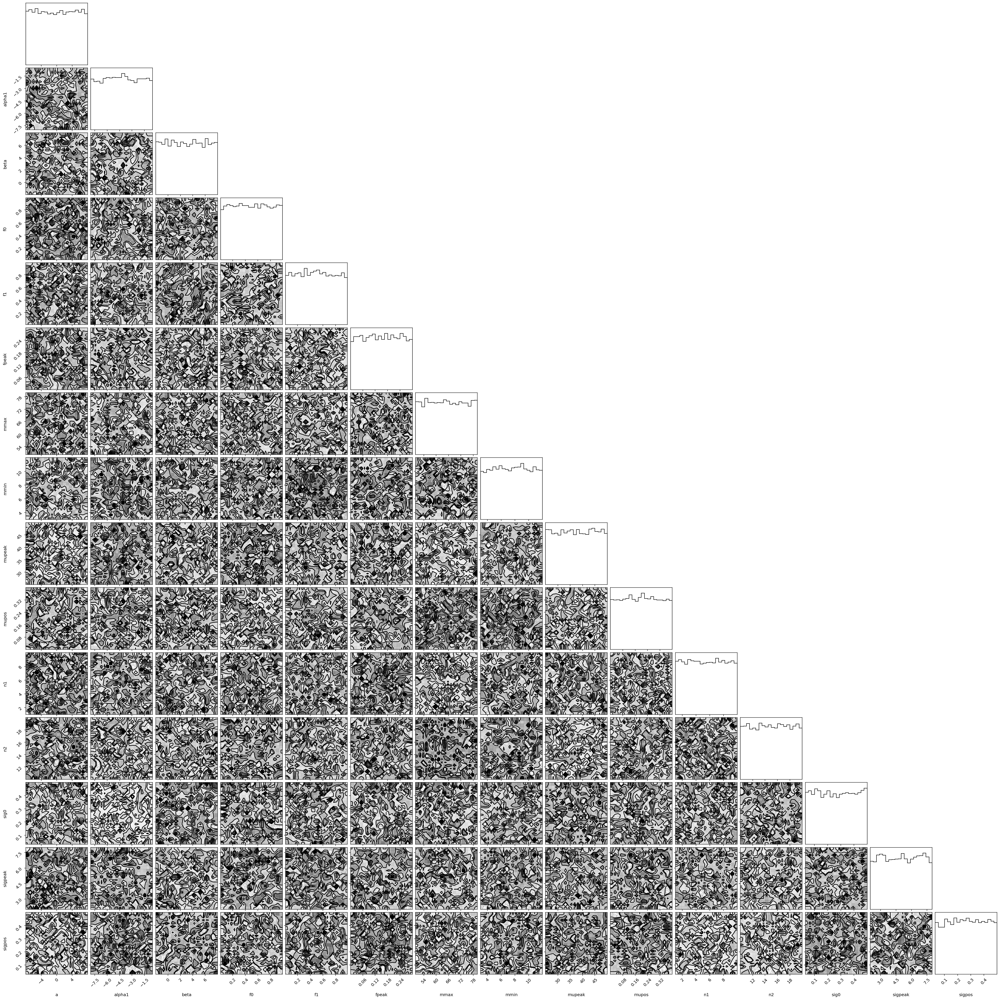

In [8]:
corner.corner(prior_samples);

### Sample from posterior

In [9]:
sampler = MCMC(NUTS(posterior), num_warmup=10000, num_samples=10000, progress_bar = True)
sampler.run(random.PRNGKey(0))

sample: 100%|████████████████████████████████████████████████████████████████████████████████████████████████| 20000/20000 [1:04:50<00:00,  5.14it/s, 15 steps of size 1.75e-01. acc. prob=0.91]


In [10]:
samples = sampler.get_samples()
sampler.print_summary()


                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      2.60      1.05      2.60      0.79      4.25   4863.92      1.00
    alpha1     -3.50      0.36     -3.52     -4.11     -2.93   3933.66      1.00
      beta      2.67      1.72      2.28      0.05      5.46   1120.41      1.00
        f0      0.57      0.37      0.70      0.06      0.99    312.91      1.02
        f1      0.55      0.25      0.57      0.16      0.96   2651.12      1.00
     fpeak      0.00      0.00      0.00      0.00      0.01   4059.82      1.00
      mmax     71.95      5.89     73.13     63.59     80.00   7624.15      1.00
      mmin      7.85      1.08      7.91      6.07      9.58   4405.48      1.00
    mupeak     33.89      1.56     34.01     31.39     36.43   4037.70      1.00
     mupos      0.09      0.09      0.06      0.00      0.23   1025.34      1.00
        n1      7.91      1.60      8.26      5.61     10.00   8028.48      1.00
        n2     14.64      2

In [11]:
with h5py.File('posterior_samples_chieff_evolve_GWTC3.h5', 'w') as out:
    for n in samples.keys():
        out.create_dataset(name = n, data = samples[n])

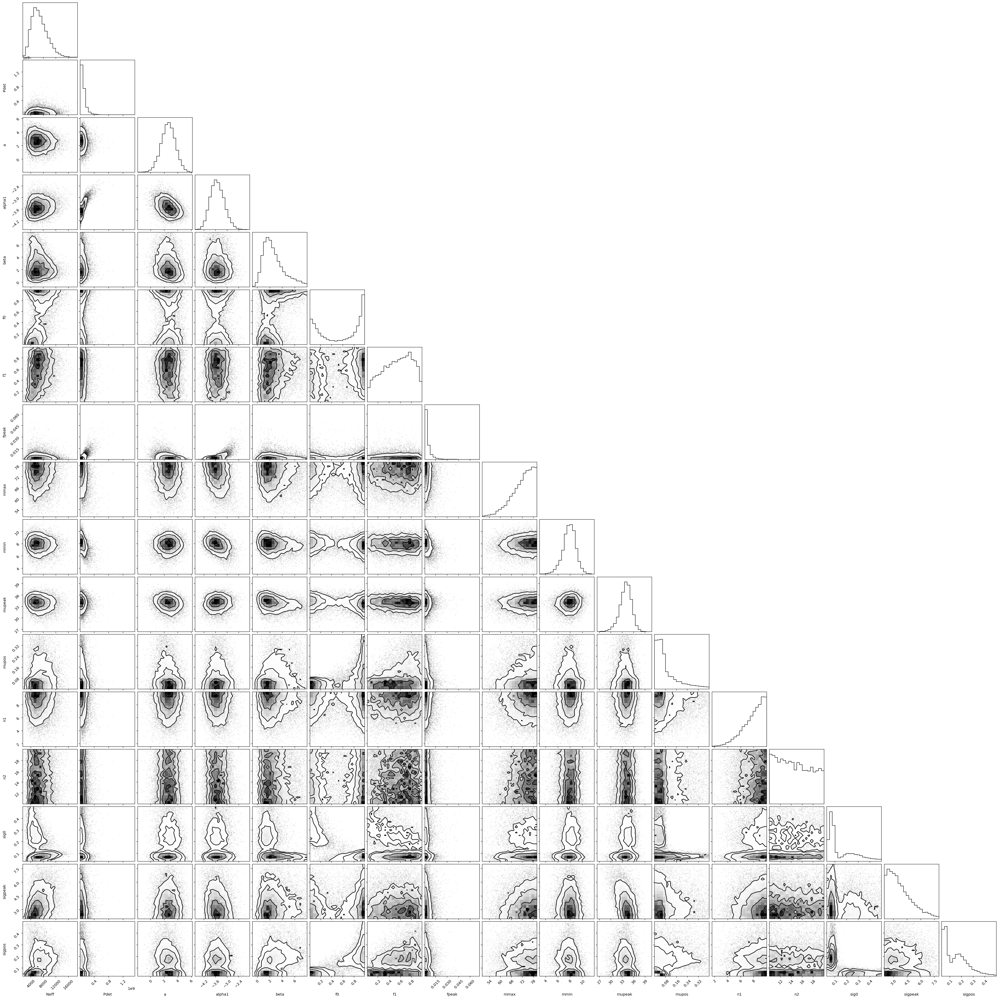

In [12]:
corner.corner(samples);

### add in rate

see https://dcc.ligo.org/DocDB/0166/T2000100/006/rates-from-monte-carlo.pdf

In [13]:
from astropy.cosmology import Planck15
from astropy import units as u

dist = mass_redshift_spin_dist(*default_params)

zmax = max(inj[:,2]) #maximum redshift we need things normalized to, this should also be larger than any PE redshift sample
z_grid = np.linspace(0.0001, zmax, 1000)
dVcdz_grid = 4 * np.pi * Planck15.differential_comoving_volume(z_grid).to(u.Gpc**3/u.sr).value

m1_grid = np.linspace(2, 100, 1000)

nsamps = len(samples['mmin'])
nus = np.zeros(nsamps)
for i in range(nsamps):
    dist.update(dict([(n, samples[n][i]) for n in dist._params]))
    nus[i] = numpyro_sample.normPdet(dist, inj, logpdraw_dz,  Ndraw, Tobs_years, z_grid, dVcdz_grid, m1_grid, m2_grid = None, chi_grid = None)

In [14]:
import scipy.stats as ss

Nexp_draw = ss.gamma.rvs(PEsamples.shape[0], size = nsamps)

Ns = Nexp_draw/nus/Tobs_years

z_plot = np.linspace(0, 1.5, 50)

logRzs = np.zeros((nsamps, len(z_plot)))

for i in range(nsamps):
    dist.update(dict([(n, samples[n][i]) for n in dist._params]))
    z = z_plot
    logRzs[i,:] = jnp.log(Ns[i]) + dist.logdNdzdist(z, z_grid, dVcdz_grid) - dist.logdNdznorm(z_grid, dVcdz_grid) + jnp.log(1 + z) - jnp.log(jnp.interp(z, z_grid, dVcdz_grid))

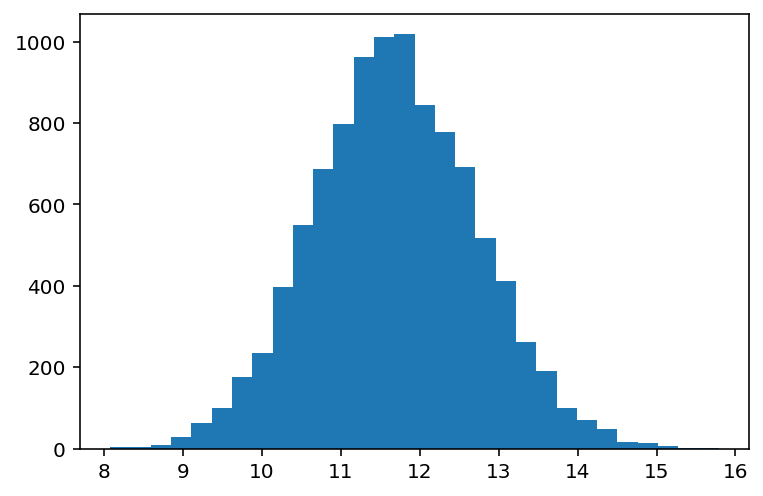

In [21]:
plt.hist(np.log(Ns), bins = 30)
plt.show()
nsamps_prior = len(prior_samples['mmin'])
logNs_prior = 7 + 10 * np.random.rand(nsamps_prior)
Ns_prior = np.exp(logNs_prior)

In [22]:
logRzs_prior = np.zeros((nsamps_prior, len(z_plot)))

for i in range(nsamps_prior):
    dist.update(dict([(n, prior_samples[n][i]) for n in dist._params]))
    z = z_plot
    logRzs_prior[i,:] = jnp.log(Ns_prior[i]) + dist.logdNdzdist(z, z_grid, dVcdz_grid) - dist.logdNdznorm(z_grid, dVcdz_grid) + jnp.log(1 + z) - jnp.log(jnp.interp(z, z_grid, dVcdz_grid))

Text(0.5, 1.0, 'posterior')

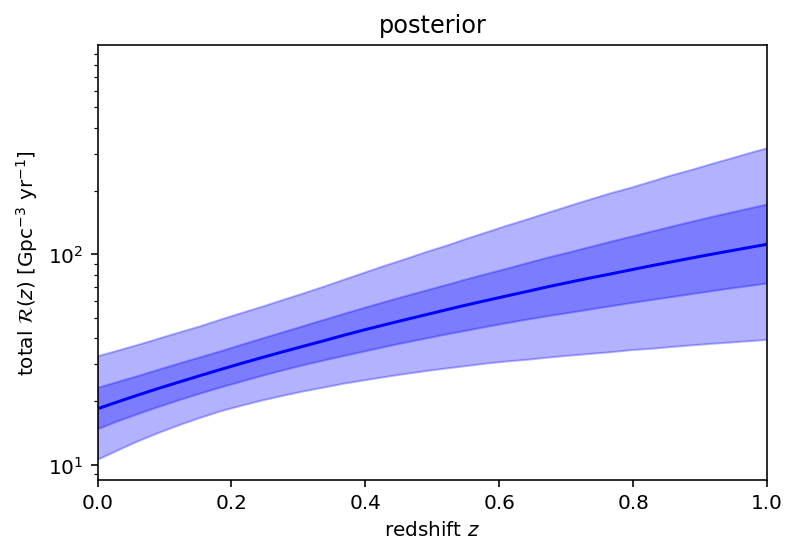

In [23]:
plt.plot(z_plot, np.percentile(np.exp(logRzs), 50, axis = 0), color = 'blue')
plt.fill_between(z_plot, np.percentile(np.exp(logRzs), 5, axis = 0), np.percentile(np.exp(logRzs), 95, axis = 0), alpha = 0.3, color = 'blue')
plt.fill_between(z_plot, np.percentile(np.exp(logRzs), 25, axis = 0), np.percentile(np.exp(logRzs), 75, axis = 0), alpha = 0.3, color = 'blue')

plt.yscale('log')
plt.xlim(min(z_plot), 1)

plt.xlabel(r'redshift $z$')
plt.ylabel(r'total $\mathcal{R}(z)$ [Gpc$^{-3}$ yr$^{-1}$]')
plt.title('posterior')

Text(0.5, 1.0, 'prior')

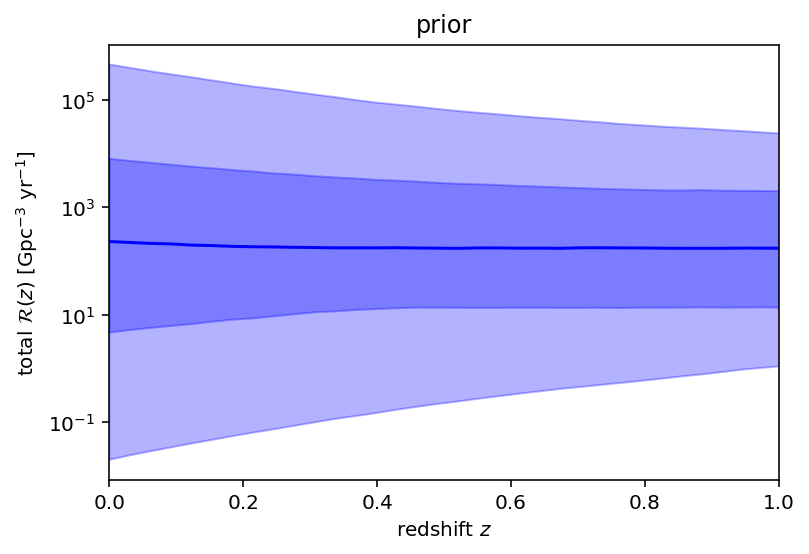

In [24]:
plt.plot(z_plot, np.percentile(np.exp(logRzs_prior), 50, axis = 0), color = 'blue')
plt.fill_between(z_plot, np.percentile(np.exp(logRzs_prior), 5, axis = 0), np.percentile(np.exp(logRzs_prior), 95, axis = 0), alpha = 0.3, color = 'blue')
plt.fill_between(z_plot, np.percentile(np.exp(logRzs_prior), 25, axis = 0), np.percentile(np.exp(logRzs_prior), 75, axis = 0), alpha = 0.3, color = 'blue')

plt.yscale('log')
plt.xlim(min(z_plot), 1)

plt.xlabel(r'redshift $z$')
plt.ylabel(r'total $\mathcal{R}(z)$ [Gpc$^{-3}$ yr$^{-1}$]')

plt.title('prior')

### negative $\chi_\mathrm{eff}$ fraction as a function of redshift

In [25]:
chis = np.linspace(-1, 0, 100)
negfrac_z = np.zeros((nsamps, len(z_plot)))

for i in range(nsamps):
    dist.update(dict([(n, samples[n][i]) for n in dist._params]))
    negfrac_z[i, :] = np.array([jnp.trapz(jnp.exp(dist.logchidist(chis, z)), chis) for z in z_plot])

In [34]:
chis = np.linspace(-1, 0, 100)
negfrac_z_prior = np.zeros((nsamps, len(z_plot)))

for i in range(nsamps):
    dist.update(dict([(n, prior_samples[n][i]) for n in dist._params]))
    negfrac_z_prior[i, :] = np.array([jnp.trapz(jnp.exp(dist.logchidist(chis, z)), chis) for z in z_plot])

In [27]:
chis = np.linspace(-1, -0.02, 100)
signegfrac_z = np.zeros((nsamps, len(z_plot)))

for i in range(nsamps):
    dist.update(dict([(n, samples[n][i]) for n in dist._params]))
    signegfrac_z[i, :] = np.array([jnp.trapz(jnp.exp(dist.logchidist(chis, z)), chis) for z in z_plot])

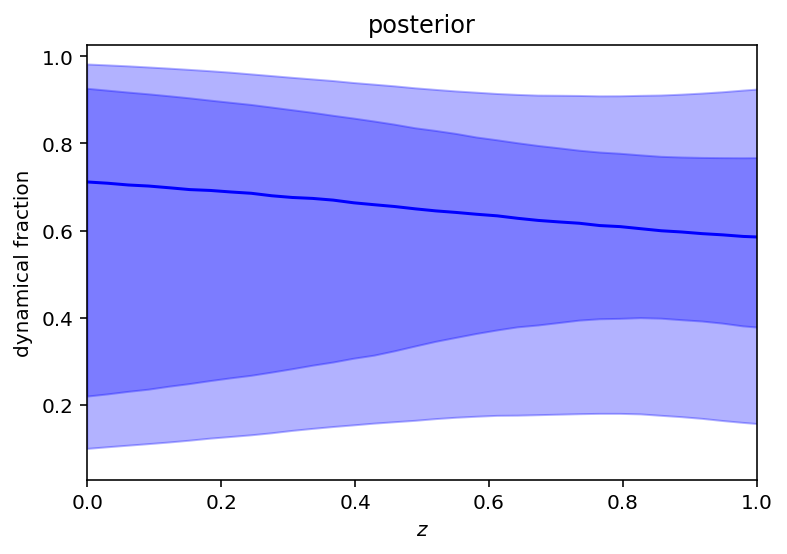

In [26]:
dynfrac_z = 2 * negfrac_z
plt.plot(z_plot, np.median(dynfrac_z, axis = 0), color = 'blue')
plt.fill_between(z_plot, np.percentile(dynfrac_z, 5, axis = 0), np.percentile(dynfrac_z, 95, axis = 0), alpha = 0.3, color = 'blue')
plt.fill_between(z_plot, np.percentile(dynfrac_z, 25, axis = 0), np.percentile(dynfrac_z, 75, axis = 0), alpha = 0.3, color = 'blue')

plt.xlim(0, 1)

plt.xlabel(r'$z$')
plt.ylabel('dynamical fraction')
plt.title('posterior')
plt.show()

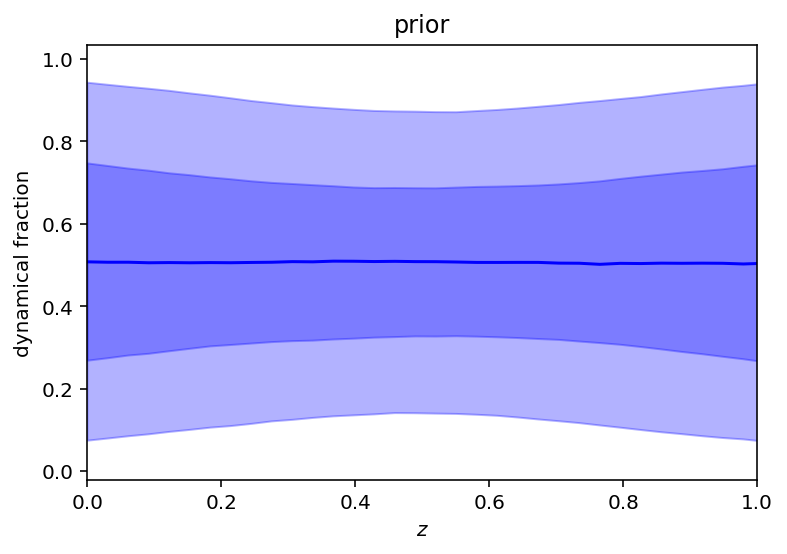

In [35]:
dynfrac_z_prior = 2 * negfrac_z_prior
plt.plot(z_plot, np.median(dynfrac_z_prior, axis = 0), color = 'blue')
plt.fill_between(z_plot, np.percentile(dynfrac_z_prior, 5, axis = 0), np.percentile(dynfrac_z_prior, 95, axis = 0), alpha = 0.3, color = 'blue')
plt.fill_between(z_plot, np.percentile(dynfrac_z_prior, 25, axis = 0), np.percentile(dynfrac_z_prior, 75, axis = 0), alpha = 0.3, color = 'blue')

plt.xlim(0, 1)

plt.xlabel(r'$z$')
plt.ylabel('dynamical fraction')
plt.title('prior')
plt.show()

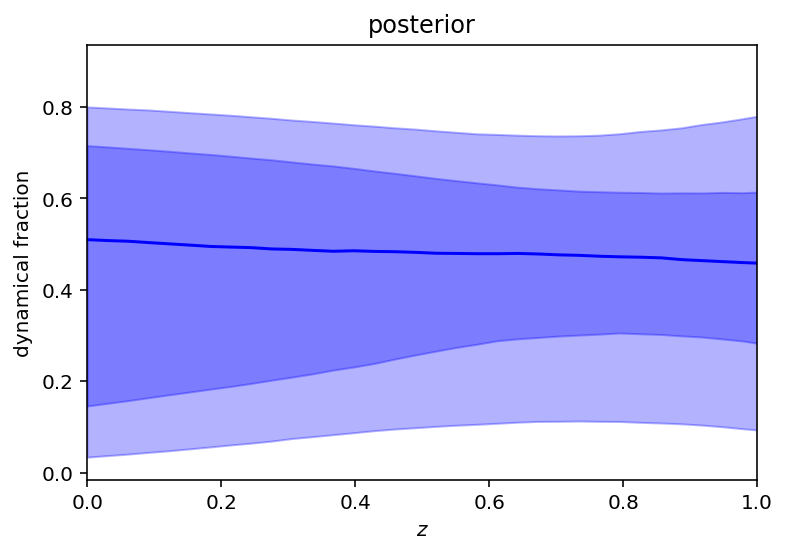

In [28]:
dynfrac_z1 = 2 * signegfrac_z
plt.plot(z_plot, np.median(dynfrac_z1, axis = 0), color = 'blue')
plt.fill_between(z_plot, np.percentile(dynfrac_z1, 5, axis = 0), np.percentile(dynfrac_z1, 95, axis = 0), alpha = 0.3, color = 'blue')
plt.fill_between(z_plot, np.percentile(dynfrac_z1, 25, axis = 0), np.percentile(dynfrac_z1, 75, axis = 0), alpha = 0.3, color = 'blue')

plt.xlim(0, 1)

plt.xlabel(r'$z$')
plt.ylabel('dynamical fraction')
plt.title('posterior')
plt.show()

Text(0, 0.5, 'dynamics $\\mathcal{R}_\\mathrm{dyn}(z)$ [Gpc$^{-3}$ yr$^{-1}$]')

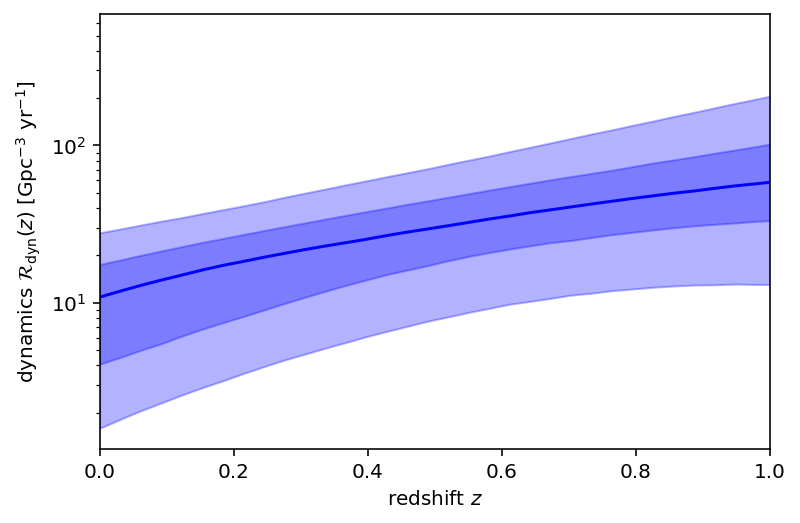

In [29]:
plt.plot(z_plot, np.percentile(np.exp(logRzs) * dynfrac_z, 50, axis = 0), color = 'blue')
plt.fill_between(z_plot, np.percentile(np.exp(logRzs) * dynfrac_z, 5, axis = 0), np.percentile(np.exp(logRzs) * dynfrac_z, 95, axis = 0), alpha = 0.3, color = 'blue')
plt.fill_between(z_plot, np.percentile(np.exp(logRzs) * dynfrac_z, 25, axis = 0), np.percentile(np.exp(logRzs) * dynfrac_z, 75, axis = 0), alpha = 0.3, color = 'blue')

plt.yscale('log')
plt.xlim(min(z_plot), 1)

plt.xlabel(r'redshift $z$')
plt.ylabel(r'dynamics $\mathcal{R}_\mathrm{dyn}(z)$ [Gpc$^{-3}$ yr$^{-1}$]')

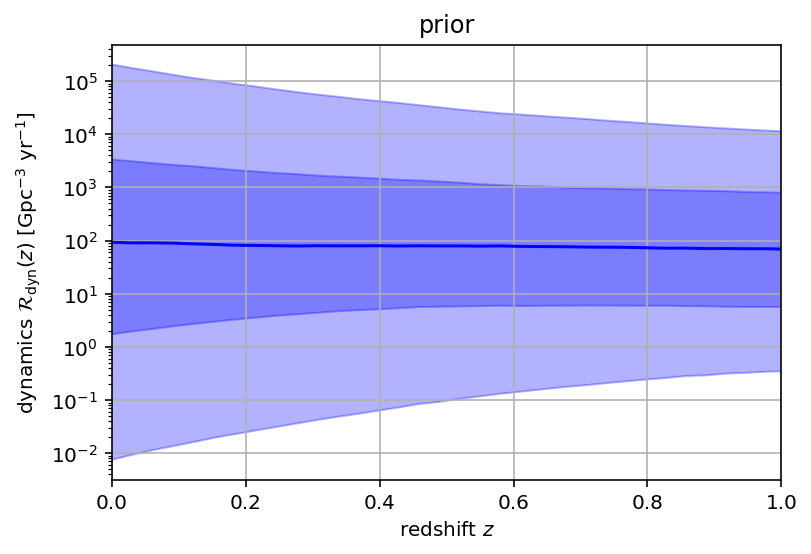

In [37]:
plt.plot(z_plot, np.percentile(np.exp(logRzs_prior) * dynfrac_z_prior, 50, axis = 0), color = 'blue')
plt.fill_between(z_plot, np.percentile(np.exp(logRzs_prior) * dynfrac_z_prior, 5, axis = 0), np.percentile(np.exp(logRzs_prior) * dynfrac_z_prior, 95, axis = 0), alpha = 0.3, color = 'blue')
plt.fill_between(z_plot, np.percentile(np.exp(logRzs_prior) * dynfrac_z_prior, 25, axis = 0), np.percentile(np.exp(logRzs_prior) * dynfrac_z_prior, 75, axis = 0), alpha = 0.3, color = 'blue')

plt.yscale('log')
plt.xlim(min(z_plot), 1)

plt.xlabel(r'redshift $z$')
plt.ylabel(r'dynamics $\mathcal{R}_\mathrm{dyn}(z)$ [Gpc$^{-3}$ yr$^{-1}$]')
plt.title('prior')
plt.grid()

In [30]:
with h5py.File('GW_dynrate_versus_z.h5', 'w') as out:
    out.create_dataset(name = 'dyn_rate', data = np.exp(logRzs) * dynfrac_z)
    out.create_dataset(name = 'dyn_rate_signeg', data = np.exp(logRzs) * dynfrac_z1)
    out.create_dataset(name = 'z', data = z_plot)
    out.create_dataset(name = 'total_rate', data = np.exp(logRzs))

/opt/anaconda3/envs/jaxpop/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


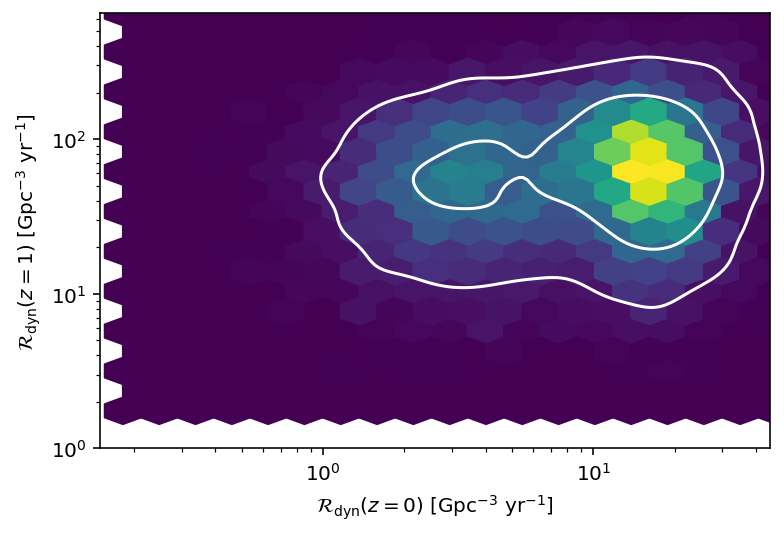

In [32]:
dyn_rate_0 = np.exp(logRzs[:,0]) * dynfrac_z[:,0]
dyn_rate_0_sig = np.exp(logRzs[:,0]) * dynfrac_z1[:,0]
ind_1 = np.arange(len(z_plot))[z_plot >= 1][0]
dyn_rate_1 = np.exp(logRzs[:,ind_1]) * dynfrac_z[:,ind_1]
dyn_rate_1_sig = np.exp(logRzs[:,ind_1]) * dynfrac_z1[:,ind_1]



import seaborn 
plt.hexbin(dyn_rate_0, dyn_rate_1, gridsize = 20, xscale = 'log', yscale = 'log')
seaborn.kdeplot(dyn_rate_0, dyn_rate_1, log_scale = True, levels = [0.1, 0.5], color = 'white')
plt.xlim(0.15, 45)
plt.ylim(1, 650)
plt.xlabel('$\mathcal{R}_\mathrm{dyn}(z = 0)$ [Gpc$^{-3}$ yr$^{-1}$]')
plt.ylabel('$\mathcal{R}_\mathrm{dyn}(z = 1)$ [Gpc$^{-3}$ yr$^{-1}$]')
plt.show()

In [46]:
dyn_rate_0_prior = np.exp(logRzs_prior[:,0]) * dynfrac_z_prior[:,0]
dyn_rate_1_prior = np.exp(logRzs_prior[:,ind_1]) * dynfrac_z_prior[:,ind_1]

In [39]:
with h5py.File('GW_dynrate_z0_z1.h5', 'w') as out:
    out.create_dataset(name = 'dyn_rate_z0', data = dyn_rate_0)
    out.create_dataset(name = 'dyn_rate_z1', data = dyn_rate_1)
    out.create_dataset(name = 'dyn_rate_z0_signeg', data = dyn_rate_0_sig)
    out.create_dataset(name = 'dyn_rate_z1_signeg', data = dyn_rate_1_sig)
    out.create_dataset(name = 'dyn_rate_z0_prior', data = dyn_rate_0_prior)
    out.create_dataset(name = 'dyn_rate_z1_prior', data = dyn_rate_1_prior)

### Some other sanity checks

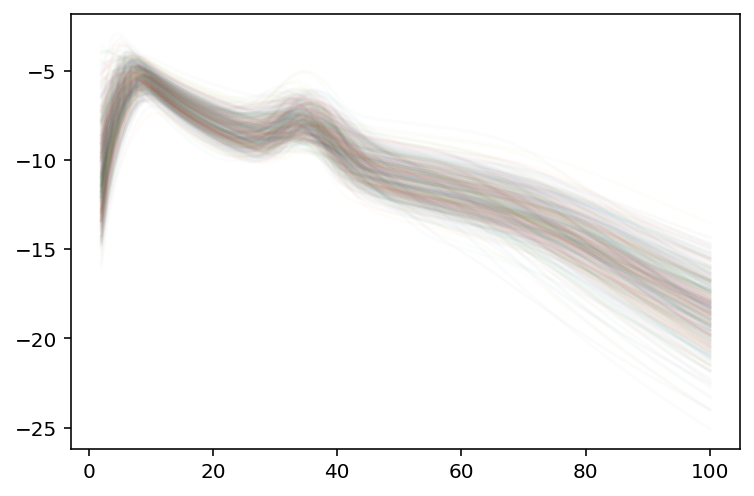

In [40]:
dist = mass_redshift_spin_dist(*default_params)
ms = np.linspace(2, 100, 100)
for i in range(500):
    dist.update(dict([(n, samples[n][i]) for n in dist._params]))
    plt.plot(ms, dist.logm1dist(ms), alpha = 0.02)

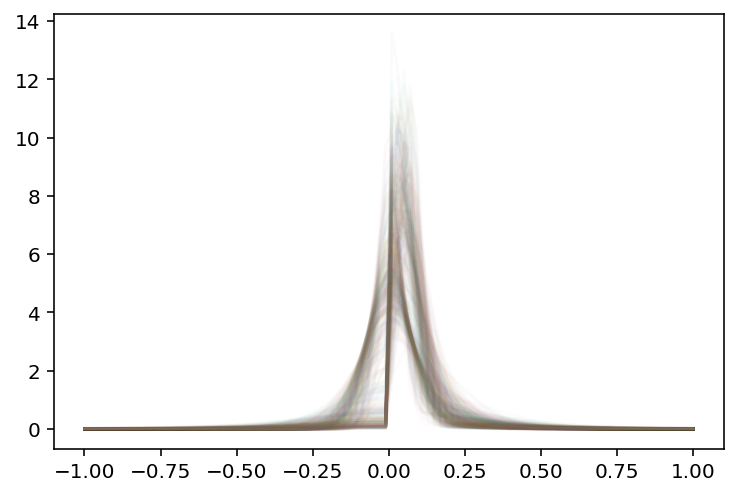

In [41]:
dist = mass_redshift_spin_dist(*default_params)
chis = np.linspace(-1, 1, 100)
z = 0.2
for i in range(500):
    dist.update(dict([(n, samples[n][i]) for n in dist._params]))
    plt.plot(chis, jnp.exp(dist.logchidist(chis, z)), alpha = 0.02)
plt.show()
#zs = np.linspace(0, 1.5, 100)
#for i in range(100):
#    plt.plot(zs, evolve_bounded(zs, samples['f0'][i], samples['f1'][i]) , alpha = 0.1)
#plt.show()

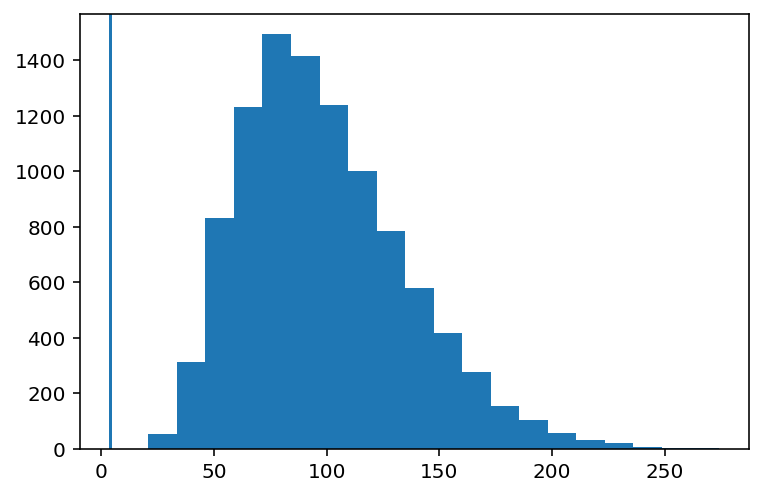

In [42]:
plt.hist(samples["Neff"]/PEsamples.shape[0], bins = 20)
plt.axvline(4)
plt.show()

This fpeak is much smaller than the usual PL+Peak fit, this is because this is fpeak relative to a normalized power law between 2 and 100, and then the whole thing gets bandpassed. 

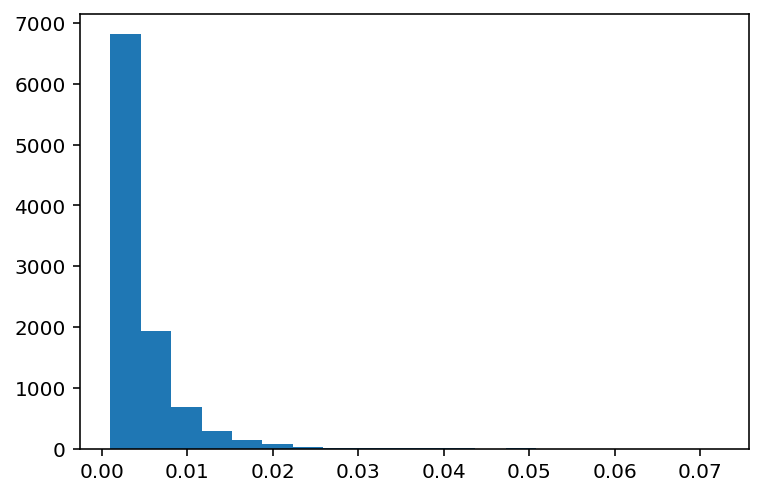

In [43]:
plt.hist(samples["fpeak"], bins = 20)
plt.show()